# Single Image Super Resolution with SRGAN

This is an implementation of SRGAN using Tensorflow.  
SRGAN is a single image super resolution algorithm proposed in https://arxiv.org/pdf/1609.04802.pdf.  

In this implementation VGG(2,2) loss is used. And the model is not fully trained due to computational limitations.  
There are several differences between my implementation and the original paper:
1. Training data, I used DIV2K dataset.
2. I reduced the number of residual blocks in the networks for faster training.
3. Learning rate is kept the same here.

In [30]:
import numpy as np
import tensorflow as tf
from tensorflow.keras import layers, models
from custom_image_dataset_from_directory import image_dataset_from_directory
import matplotlib.pyplot as plt
import os
from PIL import Image
import utils
import time
from IPython import display

In [31]:
upscale_factor = 4
batch_size = 32

# Size for the training images
lr_image_size = (32,32) 
hr_image_size = (lr_image_size[0] * upscale_factor, lr_image_size[1] * upscale_factor)

# Stride for the cropping images
lr_stride = (lr_image_size[0] * 3 // 4, lr_image_size[1] * 3 // 4) 
hr_stride = (lr_stride[0] * upscale_factor, lr_stride[1] * upscale_factor)

model_dir = 'models'

# 1. Data Preprocessing

DIV2K is used for training.  
Set5, Set14, B100, Urban100, Manga109 can be used for testing.

Training images are cropped into square sub images of train_image_size using the custom image_dataset_from_directory() function.  
Note that ```image_dataset_from_directory()``` is modified from the tensorflow source code (https://github.com/keras-team/keras/blob/v2.7.0/keras/preprocessing/image_dataset.py#L30-L227) for generating the dataset with cropping rather than the default ```smart_resize()```. Set crop_to_aspect_ratio=True if you want to use the ```smart_resize()```.

In [33]:
# Load the DIV2K dataset
train_lr_dir = 'data/DIV2K/train/LRx4_bicubic'
train_hr_dir = 'data/DIV2K/train/HR'

train_ds = image_dataset_from_directory(train_lr_dir, train_hr_dir, image_size=lr_image_size, stride=lr_stride, upscale_factor=upscale_factor, batch_size=batch_size, shuffle=True, num_sub_images=10)

# Validation dataset
val_lr_dir = 'data/DIV2K/validation/LRx4_bicubic'
val_hr_dir = 'data/DIV2K/validation/HR'

val_ds = image_dataset_from_directory(val_lr_dir, val_hr_dir, image_size=lr_image_size, stride=lr_stride,
                                   upscale_factor=upscale_factor, batch_size=batch_size, shuffle=True, num_sub_images=10)


Only run the the block below for debug / if you really want to know the number of sub-images created.  
It takes 2 minutes for the DIV2K dataset, which has 800 images

In [34]:
# def num_elements_in_dataset(ds):
#     num_elements = 0
#     it = iter(ds)
#     for batch in it:
#         num_elements += batch[0].shape[0]

#     return num_elements
# print(next(iter(train_ds))[0].shape)
# print("Number of sub-images in training set:", num_elements_in_dataset(train_ds))
# print("Number of sub-images in validation set:", num_elements_in_dataset(val_ds))

In [35]:
# Normalize the images
normalize = layers.Rescaling(1./255)
train_ds = train_ds.map(lambda image_batch, label_batch: (normalize(image_batch), normalize(label_batch)))
val_ds = val_ds.map(lambda image_batch, label_batch: (normalize(image_batch), normalize(label_batch)))

(32, 32, 3) (128, 128, 3)


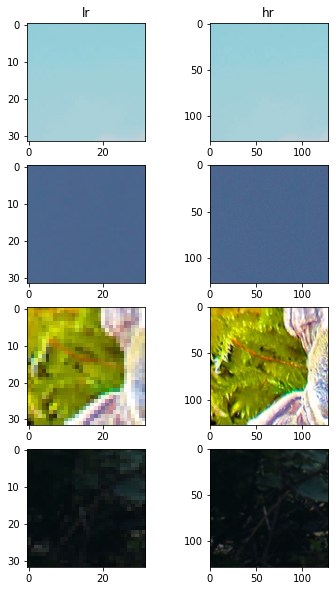

In [36]:
# Visualize Training Data
fig, ax = plt.subplots(nrows=4, ncols=2, figsize=(6,10))

for i in range(4):
    image = next(iter(train_ds))
    ax[i][0].imshow(image[0][i].numpy().astype('float32'))
    ax[i][1].imshow(image[1][i].numpy().astype('float32'))

ax[0][0].set_title("lr")
ax[0][1].set_title("hr")

print(image[0][i].numpy().shape, image[1][i].numpy().shape)

# 2. Train Model

In [37]:
def discriminator_network():
    """Discriminator Network"""
    def conv_block(x, filter=64, kernel_size=(3,3), strides=(1,1)):
        x = layers.Conv2D(filter, kernel_size, strides=strides, padding="same")(x)
        x = layers.BatchNormalization()(x)
        x = layers.LeakyReLU(alpha=0.2)(x)
        return x
    
    # Input lr image
    input_lr = tf.keras.Input(shape=(hr_image_size[0], hr_image_size[1], 3))
    x = layers.Conv2D(64, (3,3), strides=(1,1), padding="same")(input_lr)
    x = layers.LeakyReLU()(x)
    x = conv_block(x, filter=64, kernel_size=(3,3), strides=(2,2))
    x = conv_block(x, filter=128, kernel_size=(3,3), strides=(1,1))
    x = conv_block(x, filter=128, kernel_size=(3,3), strides=(2,2))
    x = conv_block(x, filter=256, kernel_size=(3,3), strides=(1,1))
    x = conv_block(x, filter=256, kernel_size=(3,3), strides=(2,2))
    x = conv_block(x, filter=512, kernel_size=(3,3), strides=(1,1))
    x = conv_block(x, filter=512, kernel_size=(3,3), strides=(2,2))
    x = layers.Flatten()(x)
    x = layers.Dense(1024)(x)
    x = layers.LeakyReLU(0.2)(x)
    output = layers.Dense(1, activation="sigmoid")(x)

    model = models.Model(inputs=input_lr, outputs=output)
    return model

def generator_network():
    """Generator Network"""
    num_res_block = 2

    def residual_block():
        # Convolution Layers Stacks
        model = models.Sequential([
            layers.Conv2D(64, (3,3), padding="same"),
            layers.BatchNormalization(),
            layers.PReLU(shared_axes=[1, 2]),
            layers.Conv2D(64, (3,3), padding="same"),
            layers.BatchNormalization()
        ])
        return model
    
    def upscale_block(x, factor=2):
        x = layers.Conv2D(64 * factor * factor, (9,9), padding="same")(x)
        x = tf.nn.depth_to_space(x, factor)
        x = layers.PReLU(shared_axes=[1, 2])(x)
        return x
    
    # Input lr image
    input_lr = tf.keras.Input(shape=(None,None,3))

    input_conv = layers.Conv2D(64, (9,9), padding="same")(input_lr)
    input_conv = layers.PReLU(shared_axes=[1, 2])(input_conv)

    # Residual Blocks
    x = input_conv
    for _ in range(num_res_block):
        output_res = residual_block()(x)
        x = layers.Add()([x, output_res])

    x = layers.Conv2D(64, (3,3), padding="same")(x)
    x = layers.BatchNormalization()(x)
    x = layers.Add()([x, input_conv])

    # Upscale
    x = upscale_block(x, factor=2)
    x = upscale_block(x, factor=2)

    # Output hr image
    output = layers.Conv2D(3, (9,9), padding="same")(x)

    model = models.Model(inputs=input_lr, outputs=output)
    return model
    
# Load the VGG19 Pretrained Network
vgg19 = tf.keras.applications.VGG19(weights='imagenet', include_top=False, input_shape=(hr_image_size[0], hr_image_size[1], 3))
def VGGLoss(y_true, y_pred, nPool=2, nConv=2):
    """MSE Loss between feature maps in the nConv Convolutional Layer before the nPool MaxPooling layer"""
    i = 0
    j = 0
    for layer in vgg19.layers:
        current_layer = layer.name
        y_true = layer(y_true)
        y_pred = layer(y_pred)

        if layer.__class__.__name__ == "MaxPooling2D":
            i += 1
            j = 0
        if layer.__class__.__name__ == "Conv2D":
            j += 1
        if i == nPool - 1 and j == nConv:
            break

    # print(current_layer)

    return tf.reduce_mean((y_true - y_pred) ** 2) * 0.006

def adv_loss(p):
    """Adversarial Loss designed to fool the discriminator"""
    return tf.reduce_mean(-tf.math.log(p))

def discriminator_loss(real_output, fake_output):
  real_loss = tf.keras.losses.BinaryCrossentropy()(tf.ones_like(real_output), real_output)
  fake_loss = tf.keras.losses.BinaryCrossentropy()(tf.zeros_like(fake_output), fake_output)
  total_loss = real_loss + fake_loss
  return total_loss

def psnr(y_true, y_pred):
    """Compute PSNR between two image tensors"""
    max_pixel = 1.0
    return 10 * (tf.math.log(max_pixel ** 2) - tf.math.log(tf.reduce_mean(tf.math.square(y_true - y_pred)))) / tf.math.log(10.0)

In [38]:
# Set optimizers
generator_optimizer = tf.keras.optimizers.Adam(1e-5)
discriminator_optimizer = tf.keras.optimizers.Adam(1e-5)

# Create models
generator = generator_network()
discriminator = discriminator_network()

# Save model architecture as image
_ = tf.keras.utils.plot_model(generator, to_file=os.path.join(model_dir, 'SRGAN_Generator.png'), show_shapes=True)
_ = tf.keras.utils.plot_model(discriminator, to_file=os.path.join(model_dir, 'SRGAN_Discriminator.png'), show_shapes=True)

Training Loop

In [39]:
gen_vgg_losses_history = []
gen_adv_losses_history = []
disc_losses_history = []
psnr_history = []

In [40]:
@tf.function
def train_step(batch):
    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        lr_images, hr_images = batch
        generated_images = generator(lr_images, training=True)

        hr_output = discriminator(hr_images, training=True)
        generated_output = discriminator(generated_images, training=True)
        
        gen_vgg_loss = VGGLoss(hr_images, generated_images, 2, 2)
        gen_adv_loss = adv_loss(generated_output)
        gen_loss = gen_vgg_loss + gen_adv_loss * 1e-3

        disc_loss = discriminator_loss(hr_output, generated_output)

        gen_psnr = psnr(hr_images, generated_images)
    
    gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))
    
    return gen_vgg_loss, gen_adv_loss * 1e-3, disc_loss, gen_psnr
  
def train(dataset, epochs, test_image=None):
    # Compute the number of batches
    ds_length = 0
    first_epoch = True

    epoch_history_log = []
    
    for epoch in range(epochs):
        start = time.time()

        print(f"Running Epoch {epoch + 1}")

        epoch_progress_log = []
        
        gen_vgg_losses = []
        gen_adv_losses = []
        disc_losses = []
        epoch_psnr = []

        batch_number = 0
        
        for image_batch in dataset:
            # if batch_number == 2:
            #     break
            if first_epoch:
                ds_length += 1
            batch_number += 1
            batch_start = time.time()

            # Train a batch of images
            gen_vgg_loss, gen_adv_loss, disc_loss, batch_psnr = train_step(image_batch)

            # Record the losses
            gen_vgg_losses.append(gen_vgg_loss)
            gen_adv_losses.append(gen_adv_loss)
            disc_losses.append(disc_loss)
            epoch_psnr.append(batch_psnr)
            
            # Print progress 
            if batch_number % 50 == 0:
                epoch_progress_log.append(f"{batch_number}/{ds_length} Done! Time used: {time.time() - batch_start}")
                epoch_progress_log.append(f"gen_vgg_loss: {gen_vgg_loss}, gen_adv_loss: {gen_adv_loss}, disc_loss: {disc_loss}, psnr: {batch_psnr}")
                print(epoch_progress_log[-2])
                print(epoch_progress_log[-1])
            if batch_number % 200 == 0:
                display.clear_output(wait=True)
                # Show results and print losses after every epoch
                if test_image is not None:
                    # Produce images for the GIF as you go
                    generate_and_save_images(generator, epoch + 1, batch_number, test_image)
                for log in epoch_history_log:
                    print(log)
                for log in epoch_progress_log:
                    print(log)

        # Store epoch losses
        avg_gen_vgg_loss = np.mean(np.array(gen_vgg_losses))
        avg_gen_adv_loss = np.mean(np.array(gen_adv_losses))
        avg_disc_loss = np.mean(np.array(disc_losses))
        avg_psnr = np.mean(np.array(epoch_psnr))

        gen_vgg_losses_history.append(avg_gen_vgg_loss)
        gen_adv_losses_history.append(avg_gen_adv_loss)
        disc_losses_history.append(avg_disc_loss)
        psnr_history.append(avg_psnr)

        # Show results and print losses after every epoch
        display.clear_output(wait=True)
        if test_image is not None:
            # Produce images for the GIF as you go
            generate_and_save_images(generator, epoch + 1, ds_length, test_image)

        epoch_history_log.append(f"Epoch {epoch + 1} -- Time: {time.time()-start}, gen_vgg_loss: {avg_gen_vgg_loss}, gen_adv_loss: {avg_gen_adv_loss}, disc_loss: {avg_disc_loss}, psnr: {avg_psnr}")
        for log in epoch_history_log:
            print(log)

        # Stop incrementing ds_length because we know it now
        first_epoch = False

def generate_and_save_images(model, epoch, batch, test_input):
    for i in range(len(test_input[0])):
        predictions = model(np.expand_dims(test_input[0][i], axis=0), training=False)

        if i == 0: # Show the image
            fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(12, 4))
            ax[0].imshow(test_input[0][i])
            ax[1].imshow(predictions[0])
            ax[2].imshow(test_input[1][i])
            plt.show()

        # Create directory if no such directoy
        image_dir = f"images/{i}"
        if not os.path.isdir(image_dir):
            os.makedirs(image_dir)
        # Save the generated image
        path = f'{image_dir}/image_at_epoch_{epoch+2}_batch_{batch}.png'
        tf.keras.utils.save_img(path, predictions[0])

In [41]:
# Load the Set5 dataset
set5_hr_dir = 'data/Set5'
set5_hr_images = utils.image_array_from_directory(set5_hr_dir, downscale_factor=upscale_factor)
set5_lr_images = utils.image_array_from_directory(set5_hr_dir, downscale_factor=upscale_factor, downscale=True)

test_image = (set5_lr_images, set5_hr_images)

5 images loaded from data/Set5.
5 images downscaled by a factor of 4 from data/Set5.


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


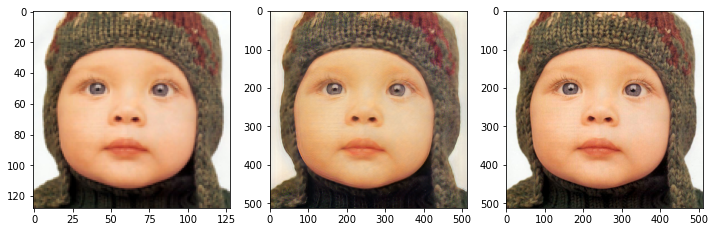

Epoch 1 -- Time: 661.2820048332214, gen_vgg_loss: 0.010691986419260502, gen_adv_loss: 0.0017568746116012335, disc_loss: 0.6374291777610779, psnr: 22.441341400146484
Epoch 2 -- Time: 659.7766191959381, gen_vgg_loss: 0.010782035999000072, gen_adv_loss: 0.0018732815515249968, disc_loss: 0.5414118766784668, psnr: 22.52012062072754
Epoch 3 -- Time: 659.955423116684, gen_vgg_loss: 0.010880442336201668, gen_adv_loss: 0.0020513792987912893, disc_loss: 0.5616128444671631, psnr: 22.526784896850586
Epoch 4 -- Time: 659.2569317817688, gen_vgg_loss: 0.011033945716917515, gen_adv_loss: 0.002177046611905098, disc_loss: 0.5421379804611206, psnr: 22.62598419189453
Epoch 5 -- Time: 659.2891278266907, gen_vgg_loss: 0.010933446697890759, gen_adv_loss: 0.0022308831103146076, disc_loss: 0.5138153433799744, psnr: 22.770008087158203


In [42]:
# Keep on training a trained model
generator.load_weights(os.path.join(model_dir, 'srgan_x4.h5'))
discriminator.load_weights(os.path.join(model_dir, 'srgan_discriminator_x4.h5'))

epochs = 5
train(train_ds, epochs, test_image)

In [43]:
# Save model
generator.save_weights(os.path.join(model_dir, 'srgan_x4.h5'))
discriminator.save_weights(os.path.join(model_dir, 'srgan_discriminator_x4.h5'))

[]

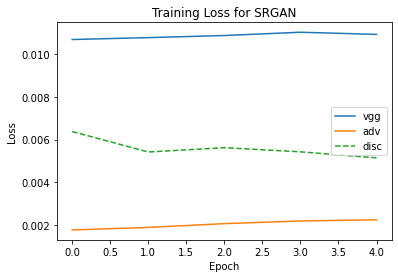

In [44]:
fig, ax = plt.subplots(figsize=(6,4))
ax.plot(gen_vgg_losses_history, label='vgg')
ax.plot(gen_adv_losses_history, label='adv')
ax.plot(np.array(disc_losses_history) / 100, label='disc', linestyle="--")
# ax.plot(history.history['val_loss'], label='Validation')

ax.set_xlabel("Epoch")
ax.set_ylabel("Loss")
ax.set_title("Training Loss for SRGAN")
ax.legend()
ax.plot()

# 3. Evaluation

In [45]:
generator.load_weights(os.path.join(model_dir, 'srgan_x4.h5'))

Because we are going to evaluate on images with different sizes, we cannot load them as a dataset like the training and validation dataset above.  
We need to load the images to numpy arrays ourselves, and then predict them one by one.  

Some datasets only provide HR images, so we need to downscale it ourselves.  
Also, an upscale function is implemented for upscaling LR images with bicubic interpolation for comparison.

In [46]:
def rescale(image, scale, downscale=False):
    image = tf.keras.preprocessing.image.array_to_img(image * 255)
    if downscale:
        image = utils.downscale_image(image, scale)
    else:
        image = utils.upscale_image(image, scale)
    image = tf.keras.preprocessing.image.img_to_array(image)
    return image / 255

### Validation Set

In [47]:
# Load the DIV2K validation dataset
val_hr_dir = 'data/DIV2K/validation/HR'
# val_lr_dir = 'data/DIV2K/validation/LRx4_unknown' # This is more difficult than bicubic downgrade
val_hr_images = utils.image_array_from_directory(val_hr_dir, downscale_factor=upscale_factor, limit=5)
val_lr_images = utils.image_array_from_directory(val_hr_dir, downscale_factor=upscale_factor, downscale=True, limit=5)

# Upscale with bicubic interpolation as baseline
bicubic_val_lr_images = []
for image in val_lr_images:
    image = tf.keras.preprocessing.image.array_to_img(image * 255)
    image = utils.upscale_image(image, upscale_factor)
    image = tf.keras.preprocessing.image.img_to_array(image)
    bicubic_val_lr_images.append(image / 255)
    

5 images loaded from data/DIV2K/validation/HR.
5 images downscaled by a factor of 4 from data/DIV2K/validation/HR.


In [48]:
# Make predictions on validation set
predictions = []
for image in val_lr_images:
    hr = generator.predict(np.expand_dims(image, axis=0))[0]
    hr = tf.clip_by_value(hr, 0, 1)
    predictions.append(hr)
    if len(predictions) > 5:
        break

psnr_bicubic = []
psnr_srgan = []
for i in range(len(predictions)):
    psnr_bicubic.append(tf.image.psnr(bicubic_val_lr_images[i], val_hr_images[i], 1.0).numpy())
    psnr_srgan.append(tf.image.psnr(predictions[i], val_hr_images[i], 1.0).numpy())
psnr_bicubic = np.array(psnr_bicubic)
psnr_srgan = np.array(psnr_srgan)

print("PSNR (Bicubic):", np.average(psnr_bicubic))
print("PSNR (SRGAN):", np.average(psnr_srgan))

2022-01-14 13:32:32.968364: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:112] Plugin optimizer for device_type GPU is enabled.
2022-01-14 13:32:39.345629: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:112] Plugin optimizer for device_type GPU is enabled.
2022-01-14 13:32:42.866674: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:112] Plugin optimizer for device_type GPU is enabled.


PSNR (Bicubic): 28.847467
PSNR (SRGAN): 25.386541


Text(0.5, 1.0, 'Ground Truth')

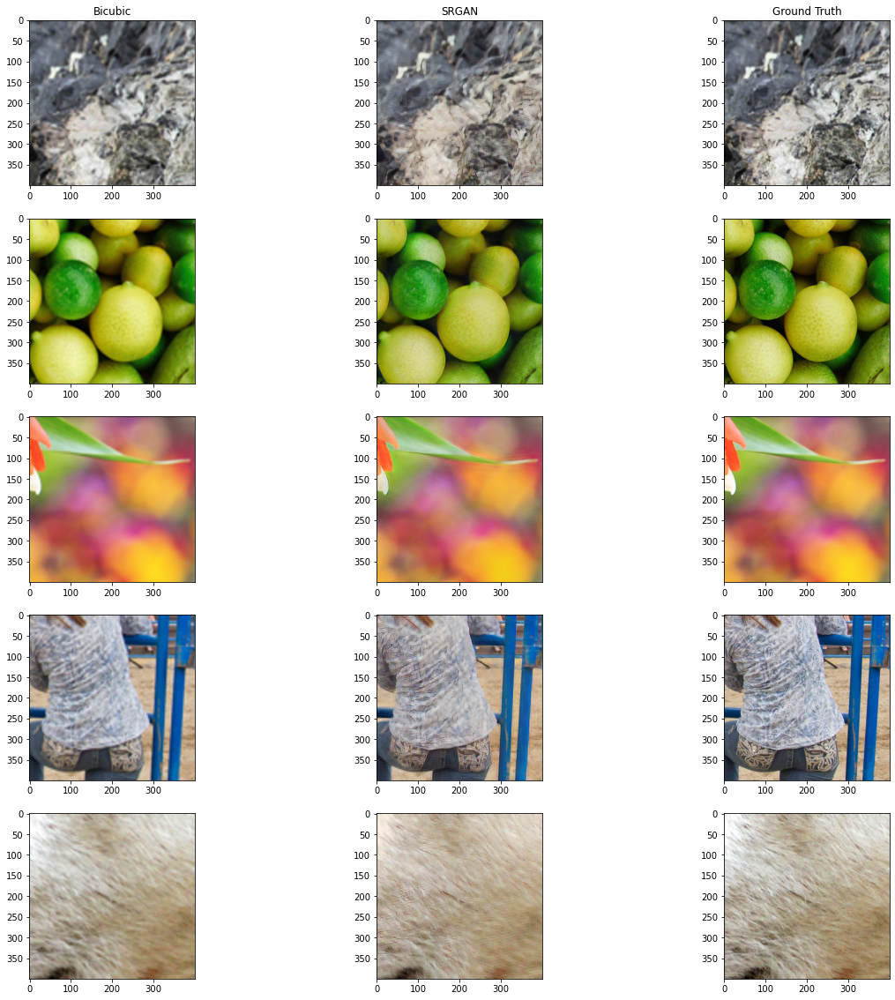

In [49]:
fig, ax = plt.subplots(nrows=5, ncols=3, figsize=(20, 20))

plot_size = 400
for i in range(5):
    x = np.random.randint(0, val_hr_images[i].shape[0]-plot_size)
    y = np.random.randint(0, val_hr_images[i].shape[1]-plot_size)
    ax[i][0].imshow(bicubic_val_lr_images[i][x:x+plot_size, y:y+plot_size,:])
    ax[i][1].imshow(predictions[i][x:x+plot_size, y:y+plot_size,:])
    ax[i][2].imshow(val_hr_images[i][x:x+plot_size, y:y+plot_size,:])

ax[0][0].set_title("Bicubic")
ax[0][1].set_title("SRGAN")
ax[0][2].set_title("Ground Truth")

### Set5

In [50]:
# Load the Set5 dataset
set5_hr_dir = 'data/Set5'
set5_hr_images = utils.image_array_from_directory(set5_hr_dir, downscale_factor=upscale_factor)
set5_lr_images = utils.image_array_from_directory(set5_hr_dir, downscale_factor=upscale_factor, downscale=True)

# Bicubic interpolation for comparison
bicubic_set5_lr_images = []
for image in set5_lr_images:
    image = tf.keras.preprocessing.image.array_to_img(image * 255)
    image = utils.upscale_image(image, upscale_factor)
    image = tf.keras.preprocessing.image.img_to_array(image)
    bicubic_set5_lr_images.append(image / 255)

5 images loaded from data/Set5.
5 images downscaled by a factor of 4 from data/Set5.


In [51]:
# Make predictions on Set5
predictions = []
for image in set5_lr_images:
    hr = generator.predict(np.expand_dims(image, axis=0))[0]
    hr = tf.clip_by_value(hr, 0, 1)
    predictions.append(hr)

psnr_bicubic = []
psnr_SRGAN = []
for i in range(len(predictions)):
    psnr_bicubic.append(tf.image.psnr(bicubic_set5_lr_images[i], set5_hr_images[i], 1.0).numpy())
    psnr_SRGAN.append(tf.image.psnr(predictions[i], set5_hr_images[i], 1.0).numpy())
psnr_bicubic = np.array(psnr_bicubic)
psnr_SRGAN = np.array(psnr_SRGAN)

print("PSNR (Bicubic):", np.average(psnr_bicubic), psnr_bicubic)
print("PSNR (SRGAN):", np.average(psnr_SRGAN), psnr_SRGAN)

2022-01-14 13:32:50.560821: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:112] Plugin optimizer for device_type GPU is enabled.


PSNR (Bicubic): 26.59675 [30.416115 28.068218 20.456728 28.963413 25.079266]
PSNR (SRGAN): 23.66728 [25.374893 24.871397 19.9751   26.332087 21.78293 ]


Text(0.5, 1.0, 'Ground Truth')

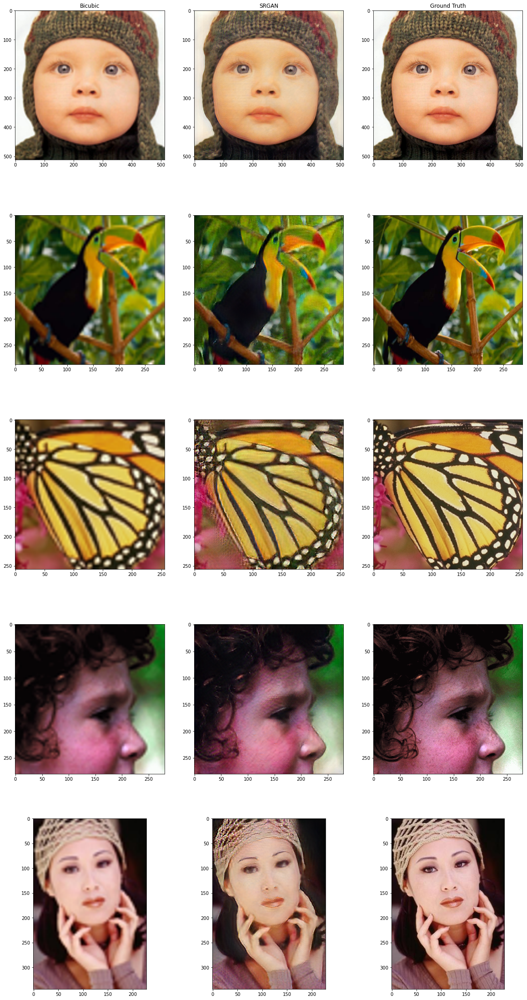

In [52]:
fig, ax = plt.subplots(nrows=5, ncols=3, figsize=(20, 40))

for i in range(5):
    ax[i][0].imshow(bicubic_set5_lr_images[i])
    ax[i][1].imshow(predictions[i])
    ax[i][2].imshow(set5_hr_images[i])

ax[0][0].set_title("Bicubic")
ax[0][1].set_title("SRGAN")
ax[0][2].set_title("Ground Truth")

### Set14

In [53]:
# Load the Set14 dataset
set14_hr_dir = 'data/Set14'
set14_hr_images = utils.image_array_from_directory(set14_hr_dir, downscale_factor=upscale_factor)
set14_lr_images = utils.image_array_from_directory(set14_hr_dir, downscale_factor=upscale_factor, downscale=True)

# Bicubic interpolation for comparison
bicubic_set14_lr_images = []
for image in set14_lr_images:
    image = tf.keras.preprocessing.image.array_to_img(image * 255)
    image = utils.upscale_image(image, upscale_factor)
    image = tf.keras.preprocessing.image.img_to_array(image)
    bicubic_set14_lr_images.append(image / 255)

14 images loaded from data/Set14.
14 images downscaled by a factor of 4 from data/Set14.


In [54]:
# Make predictions on Set14
predictions = []
for image in set14_lr_images:
    hr = generator.predict(np.expand_dims(image, axis=0))[0]
    hr = tf.clip_by_value(hr, 0, 1)
    predictions.append(hr)

psnr_bicubic = []
psnr_SRGAN = []
for i in range(len(predictions)):
    psnr_bicubic.append(tf.image.psnr(bicubic_set14_lr_images[i], set14_hr_images[i], 1.0).numpy())
    psnr_SRGAN.append(tf.image.psnr(predictions[i], set14_hr_images[i], 1.0).numpy())
psnr_bicubic = np.array(psnr_bicubic)
psnr_SRGAN = np.array(psnr_SRGAN)

print("PSNR (Bicubic):", np.average(psnr_bicubic))
print("PSNR (SRGAN):", np.average(psnr_SRGAN))

PSNR (Bicubic): 23.864874
PSNR (SRGAN): 22.088541


Text(0.5, 1.0, 'Ground Truth')

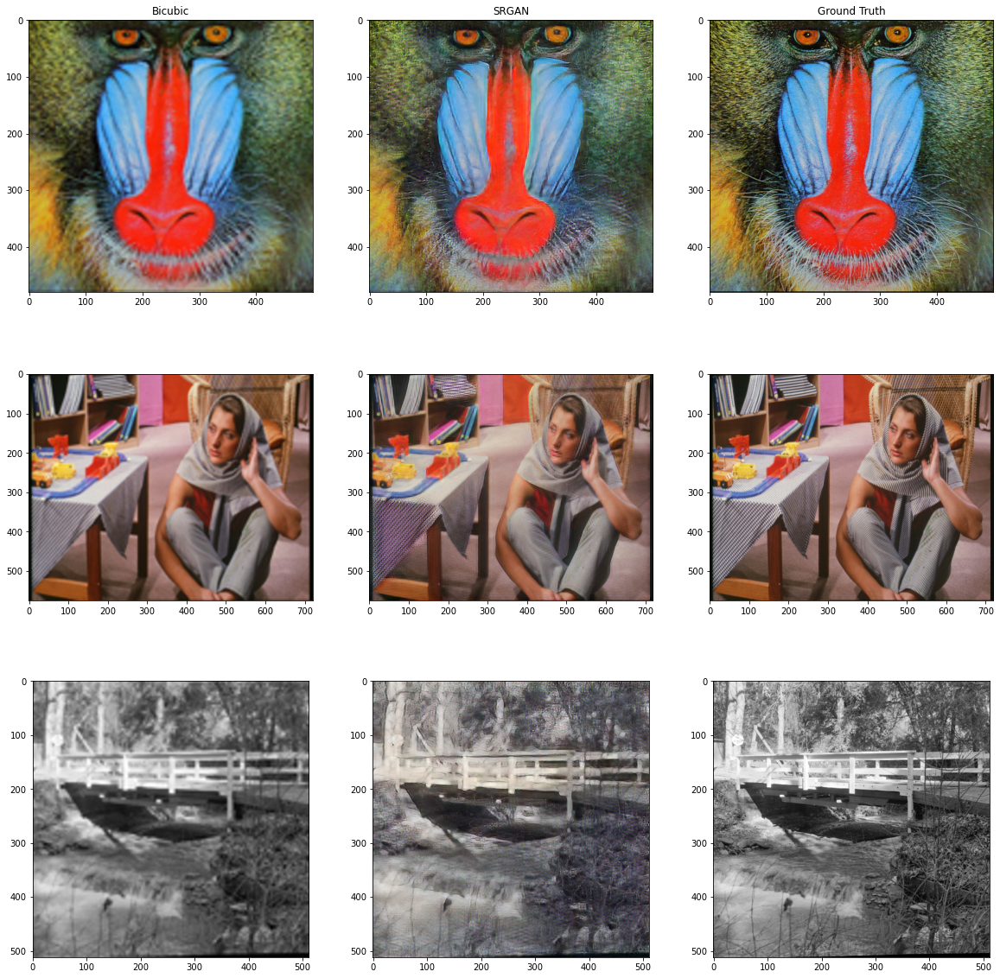

In [55]:
fig, ax = plt.subplots(nrows=3, ncols=3, figsize=(20, 20))

for i in range(3):
    ax[i][0].imshow(bicubic_set14_lr_images[i])
    ax[i][1].imshow(predictions[i])
    ax[i][2].imshow(set14_hr_images[i])

ax[0][0].set_title("Bicubic")
ax[0][1].set_title("SRGAN")
ax[0][2].set_title("Ground Truth")

## Visualizing Layer Outputs

In [56]:
import glob
import imageio

In [57]:
anim_file = 'srgan_set5_0.gif'

with imageio.get_writer(anim_file, mode='I') as writer:
  filenames = glob.glob('images/0/image*.png')
  filenames = sorted(filenames)
  for filename in filenames:
    image = imageio.imread(filename)
    writer.append_data(image)
  image = imageio.imread(filename)
  writer.append_data(image)

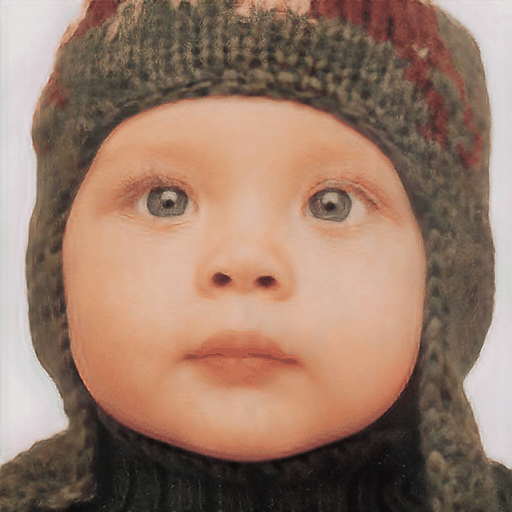

In [58]:
from IPython.display import Image
Image("srgan_set5_0.gif")